In [1]:
import os
import pathlib
import numpy as np
import matplotlib.pyplot as plt
from IPython import display
import tensorflow as tf
import time
import datetime

In [2]:
dataset = 'maps'

In [3]:
dataset_file = "{}.tar.gz".format(dataset)
dataset_url = "http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/{}".format(dataset_file)
print(dataset_url)

http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/maps.tar.gz


In [4]:
download_zip = tf.keras.utils.get_file(fname = dataset_file, origin = dataset_url, extract = True)

In [5]:
download_zip = pathlib.Path(download_zip)
path = download_zip.parent/dataset

In [6]:
path

WindowsPath('C:/Users/Zahid/.keras/datasets/maps')

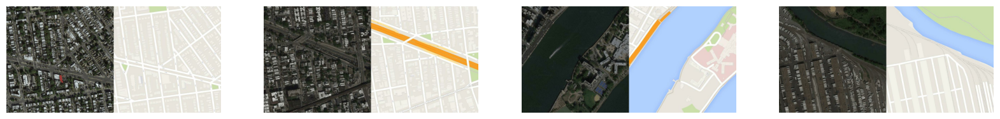

In [7]:
image_filenames = ['1.jpg', '2.jpg', '3.jpg', '4.jpg']

images = [tf.io.decode_jpeg(tf.io.read_file(str(path / 'train'/filename))) for filename in image_filenames]

plt.figure(figsize=(20, 5)) 
for i, img in enumerate(images):
    plt.subplot(1, 4, i + 1)  
    plt.imshow(img.numpy())    
    plt.axis('off')            

plt.show()

In [8]:
images[0].shape

TensorShape([600, 1200, 3])

# Training Images Preprocessing

In [9]:
#seperate the original image and map
def load_image(img_file):
    img = tf.io.read_file(img_file)
    img = tf.io.decode_jpeg(img)
    img = tf.image.resize(img, [256, 512])
    #print(img.shape)
    width = tf.shape(img)[1]
    #print(width)
    width = width//2
    #print(width)
    original_img = img[:, :width, :]
    transformed_img = img[:, width:, :]
    
    original_img = tf.cast(original_img, tf.float32)
    transformed_img = tf.cast(transformed_img, tf.float32)
    return original_img, transformed_img
    

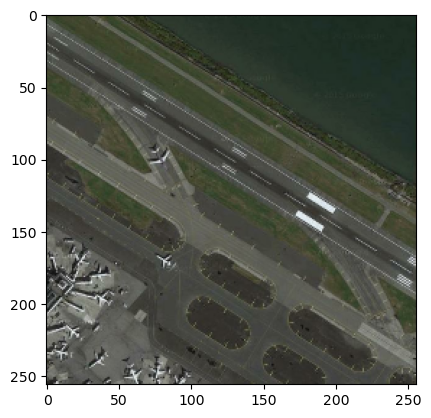

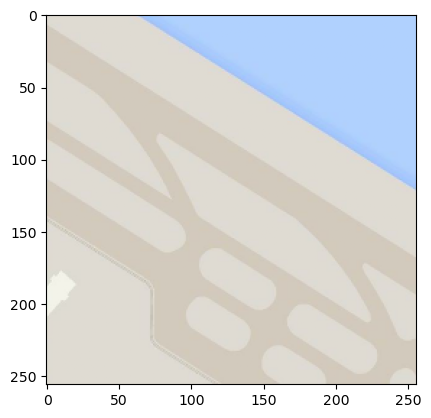

In [10]:
original_img, transformed_img = load_image(str(path / 'train/50.jpg'))
plt.figure()
plt.imshow(original_img/255.0)
plt.figure()
plt.imshow(transformed_img/255.0)

In [11]:
quantity_training = tf.data.Dataset.list_files(str(path / 'train/*.jpg'))
quantity_training 

<_ShuffleDataset element_spec=TensorSpec(shape=(), dtype=tf.string, name=None)>

In [12]:
#length of dataset
quantity_training = len(list(quantity_training))
quantity_training

1096

In [13]:
buffer_size = quantity_training
batch_size = 1
# It is recommended by the original paper to keep the dimension of training images 256*256
img_width = 256
img_height = 256

In [14]:
def resize(original_img, transformed_img, width, height):
    original_img = tf.image.resize(original_img, [width, height], method = tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    transformed_img = tf.image.resize(transformed_img, [width, height], method = tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    return original_img, transformed_img

In [15]:
def normalize(original_img, transformed_img):
    original_img = (original_img / 127.5) -1
    transformed_img = (transformed_img / 127.5) - 1
    return original_img, transformed_img

In [16]:
def random_crop(original_img, transformed_img):
    stacked_img = tf.stack([original_img, transformed_img], axis = 0)
    crop_img = tf.image.random_crop(stacked_img, size = [2, img_width, img_height, 3])
    return crop_img[0], crop_img[1]

In [17]:
@tf.function()
def random_jitter(original_img, transformed_img):
    original_img, transformed_img = resize(original_img, transformed_img, 286, 286)
    original_img, transformed_img = random_crop(original_img, transformed_img)
    if tf.random.uniform(()) > 0.5:
        original_img = tf.image.flip_left_right(original_img)
        transformed_img = tf.image.flip_left_right(transformed_img)
    return original_img, transformed_img

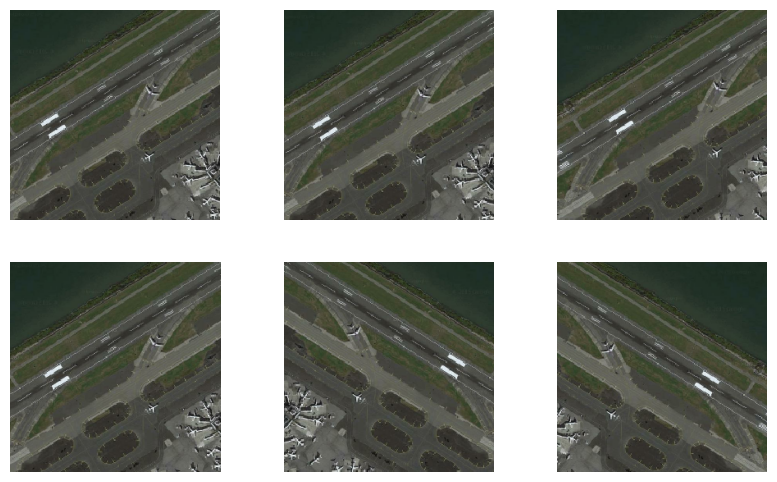

In [18]:
plt.figure(figsize = (10,6))
for i in range(6):
    j_original, j_transformed = random_jitter(original_img, transformed_img)
    plt.subplot(2,3,i+1)
    plt.imshow(j_original/255.0)
    plt.axis('off')
plt.show()

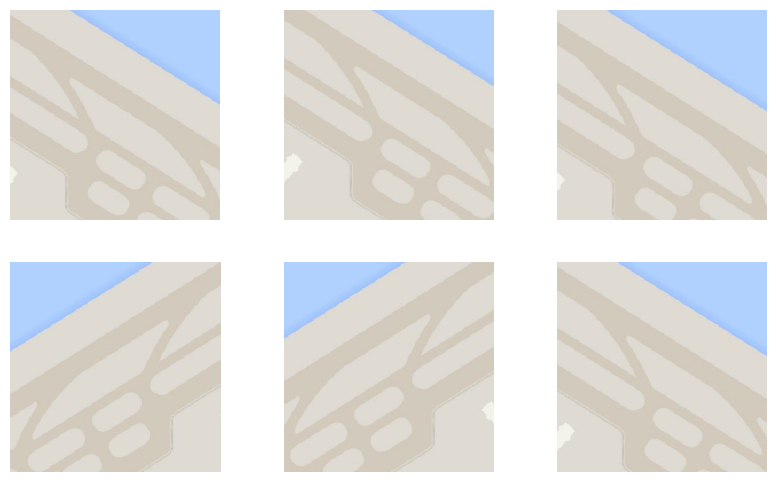

In [19]:
plt.figure(figsize = (10,6))
for i in range(6):
    j_original, j_transformed = random_jitter(original_img, transformed_img)
    plt.subplot(2,3,i+1)
    plt.imshow(j_transformed/255.0)
    plt.axis('off')
plt.show()

# Dataset Loading

In [20]:
def load_training_images(img_file):
    original_img, transformed_img = load_image(img_file)
    original_img, transformed_img = random_jitter(original_img, transformed_img)
    original_img, transformed_img = normalize(original_img, transformed_img)
    return original_img, transformed_img

In [21]:
def load_testing_images(img_file):
    original_img, transformed_img = load_image(img_file)
    original_img, transformed_img = resize(original_img, transformed_img, img_width, img_height)
    original_img, transformed_img = normalize(original_img, transformed_img)
    return original_img, transformed_img    

In [22]:
training_dataset = tf.data.Dataset.list_files(str(path / 'train/*jpg'))
training_dataset = training_dataset.map(load_training_images, num_parallel_calls=tf.data.AUTOTUNE)
training_dataset = training_dataset.shuffle(buffer_size = buffer_size)
training_dataset = training_dataset.batch(batch_size)
# Prefetch for performance
training_dataset = training_dataset.prefetch(tf.data.AUTOTUNE)

In [23]:
training_dataset

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name=None))>

In [24]:
try:
    testing_dataset = tf.data.Dataset.list_files(str(path/'test/*.jpg'))
except tf.errors.InvalidArgumentError:
    testing_dataset = tf.data.Dataset.list_files(str(path / 'val/*.jpg'))
testing_dataset = testing_dataset.map(load_testing_images)
testing_dataset = testing_dataset.batch(batch_size)

# Building the Generator

Generator is the modified version of U-Net\
** Encoder (Downsample)\
** Decoder (Upsample)

In [25]:
def encode(filters, size, apply_batchnorm = True):
    initializer = tf.random_normal_initializer(0, 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2D(filters, size, strides = 2, padding = 'same',
                                     kernel_initializer= initializer, use_bias = False))
    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())
    result.add(tf.keras.layers.LeakyReLU())
    return result

In [26]:
#test the encode function
down_model = encode(3,4)
down_result = down_model(tf.expand_dims(original_img, 0))
down_result.shape

TensorShape([1, 128, 128, 3])

In [27]:
#decode or upsample
def decode(filters, size, apply_dropout = False):
    initializer = tf.random_normal_initializer(0, 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                              kernel_initializer=initializer, use_bias=False))
    result.add(tf.keras.layers.BatchNormalization())
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    
    result.add(tf.keras.layers.ReLU())
    return result

In [28]:
up_model = decode(3,4)
up_result = up_model(down_result)
up_result.shape

TensorShape([1, 256, 256, 3])

In [29]:
def Generator():
    inputs = tf.keras.layers.Input(shape = [256,256,3])
    downsampling = [
        encode(64, 4, apply_batchnorm=False), #(batch_size, 128, 128, 64 (no of filters))
        encode(128, 4), #(batch_size, 64, 64, 128)
        encode(256, 4), #(batch_size, 32, 32, 256)
        encode(512, 4), #(batch_size, 16,16, 512)
        encode(512, 4), #(batch_size, 8, 8, 512)
        encode(512, 4), #(batch_size, 4, 4, 512)
        encode(512, 4), # (batch_size, 2, 2, 512)
        encode(512, 4), # (batch_size, 1, 1, 512)
    ]
    upsampling = [
        decode(512, 4, apply_dropout= True), #(batch_size, 2, 2, 512)
        decode(512, 4, apply_dropout= True), #(batch_size, 4, 4, 512)
        decode(512, 4, apply_dropout= True),
        decode(512, 4), 
        decode(256, 4),
        decode(128, 4),
        decode(64, 4), #(batch_size, 128, 128, 512)
        
    ]
    output_channels = 3
    initializer = tf.random_normal_initializer(0.0, 0.02)
    last = tf.keras.layers.Conv2DTranspose(output_channels, 4, strides = 2, padding='same',
                                           kernel_initializer= initializer, activation='tanh') #(batch_size, 256, 256, 3)
    x = inputs
    skips = []
    for down in downsampling:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])
    
    for up, skip in zip(upsampling, skips):
        x = up(x)
        x = tf.keras.layers.Concatenate()([x, skip])
    x = last(x)
    return tf.keras.Model(inputs = inputs, outputs = x)

In [32]:
generator = Generator()
#tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)
generator.summary()

Model: "functional_49"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_34      │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_32       │ (None, 128, 128,  │      3,072 │ input_layer_34[0… │
│ (Sequential)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_33       │ (None, 64, 64,    │    131,584 │ sequential_32[0]… │
│ (Sequential)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_34       │ (None, 32, 32,    │    525,312 │ sequential_33[0]… │
│ (Sequential)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_35       │ (None, 16, 16,    │  2,099,200 │ sequential_34[0]… │
│ (Sequential)        │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_36       │ (None, 8, 8, 512) │  4,196,352 │ sequential_35[0]… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_37       │ (None, 4, 4, 512) │  4,196,352 │ sequential_36[0]… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_38       │ (None, 2, 2, 512) │  4,196,352 │ sequential_37[0]… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_39       │ (None, 1, 1, 512) │  4,196,352 │ sequential_38[0]… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_40       │ (None, 2, 2, 512) │  4,196,352 │ sequential_39[0]… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_14      │ (None, 2, 2,      │          0 │ sequential_40[0]… │
│ (Concatenate)       │ 1024)             │            │ sequential_38[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_41       │ (None, 4, 4, 512) │  8,390,656 │ concatenate_14[0… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_15      │ (None, 4, 4,      │          0 │ sequential_41[0]… │
│ (Concatenate)       │ 1024)             │            │ sequential_37[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_42       │ (None, 8, 8, 512) │  8,390,656 │ concatenate_15[0… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_16      │ (None, 8, 8,      │          0 │ sequential_42[0]… │
│ (Concatenate)       │ 1024)             │            │ sequential_36[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_43       │ (None, 16, 16,    │  8,390,656 │ concatenate_16[0… │
│ (Sequential)        │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_17      │ (None, 16, 16,    │          0 │ sequential_43[0]

 Total params: 54,425,859 (207.62 MB)

 Trainable params: 54,414,979 (207.58 MB)

 Non-trainable params: 10,880 (42.50 KB)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


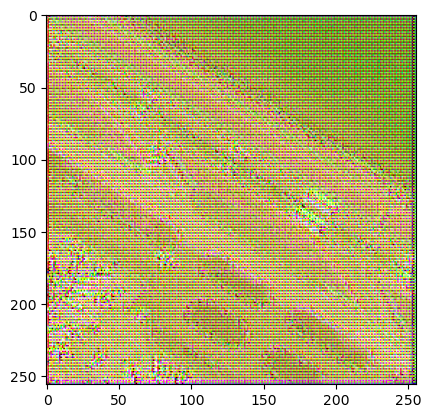

In [33]:
#define the generator loss
g_output = generator(original_img[tf.newaxis, ...], training = False)
plt.imshow(g_output[0, ...])

In [34]:
lr = 0.0002
beta1, beta2 = 0.5, 0.999
lambda_ = 100

In [35]:
loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)

Hyperparameters

Default values suggested in the paper

Learning rate: 0.0002
Momentum: [β1, β2] = [0.5, 0.999]
Lambda (λ_L1) = 100
The generator loss is a cross-entropy sigmoid of the generated images and an array of 1's
The pix2pix paper also mentions L1 loss, which is a MAE (Mean Absolute Error) between the generated image and the expected (real) one. This ensures that the generated image becomes structurally similar to the real image.
The equation for calculating the total loss is gan_loss + LAMBDA * l1_loss where LAMBDA = 100 - this value is also described by the authors of the paper.

In [36]:
def generator_loss(d_generated_output, g_output, target):
    gan_loss = loss(tf.ones_like(d_generated_output), d_generated_output)
    l1_loss = tf.reduce_mean(tf.abs(target - g_output)) #mean absolute error
    g_loss_total = gan_loss + (lambda_ * l1_loss)
    return g_loss_total, gan_loss, l1_loss

# Building the Discriminator

The discriminator is a PatchGAN. The goal is to classify if each patch (piece) of the image is real or fake.

Blocks of the discriminator: Convolution -> Batch normalization -> Leaky ReLU.

The output shape is (batch_size, 30, 30, 1)

More information: https://arxiv.org/abs/1611.07004

The discriminator receives two inputs:

The input image and the expected image, which should be classified as real
The input image and the generated image (fake, generated by the generator), which should be classified as fake.

In [37]:
def Discriminator():
    initializer = tf.random_normal_initializer(0.0, 0.02)
    
    original = tf.keras.layers.Input(shape = [256, 256, 3], name = 'original_img')
    transformed = tf.keras.layers.Input(shape = [256, 256, 3], name = 'transformed_img')
    x = tf.keras.layers.concatenate([original, transformed]) #(batch_size, 256, 256, channel * 2)
    
    down1 = encode(64, 4, False)(x) #(batch_size, 128, 128, 64)
    down2 = encode(128, 4)(down1)
    down3 = encode(256, 4)(down2)
    
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)
    conv = tf.keras.layers.Conv2D(512, 4, strides = 1, kernel_initializer= initializer, use_bias=False)(zero_pad1)
    batchnorm1 = tf.keras.layers.BatchNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)
    last = tf.keras.layers.Conv2D(1, 4, strides = 1, kernel_initializer=initializer)(zero_pad2) 
    return tf.keras.Model(inputs = [original, transformed], outputs = last)

In [38]:
import os
os.environ["PATH"] += os.pathsep + 'C:/Program Files/Graphviz/bin'  # Modify this with your actual Graphviz path

In [39]:
discriminator = Discriminator()
#tf.keras.utils.plot_model(discriminator, show_shapes = True, dpi = 64)
discriminator.summary()

Model: "functional_53"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ original_img        │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ transformed_img     │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_21      │ (None, 256, 256,  │          0 │ original_img[0][… │
│ (Concatenate)       │ 6)                │            │ transformed_img[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_47       │ (None, 128, 128,  │      6,144 │ concatenate_21[0… │
│ (Sequential)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_48       │ (None, 64, 64,    │    131,584 │ sequential_47[0]… │
│ (Sequential)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_49       │ (None, 32, 32,    │    525,312 │ sequential_48[0]… │
│ (Sequential)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d      │ (None, 34, 34,    │          0 │ sequential_49[0]… │
│ (ZeroPadding2D)     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_28 (Conv2D)  │ (None, 31, 31,    │  2,097,152 │ zero_padding2d[0… │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 31, 31,    │      2,048 │ conv2d_28[0][0]   │
│ (BatchNormalizatio… │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_28      │ (None, 31, 31,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_1    │ (None, 33, 33,    │          0 │ leaky_re_lu_28[0… │
│ (ZeroPadding2D)     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_29 (Conv2D)  │ (None, 30, 30, 1) │      8,193 │ zero_padding2d_1… │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 2,770,433 (10.57 MB)

 Trainable params: 2,768,641 (10.56 MB)

 Non-trainable params: 1,792 (7.00 KB)

In [40]:
d_output = discriminator([original_img[tf.newaxis, ...], g_output], training = False)


In [41]:
#discriminator loss
def discriminator_loss(d_real_output, d_generated_output):
    real_loss = loss(tf.ones_like(d_real_output), d_real_output)
    generated_loss = loss(tf.zeros_like(d_generated_output), d_generated_output)
    d_total_loss = real_loss + generated_loss
    return d_total_loss

In [42]:
#optimizer
generator_optimizer = tf.keras.optimizers.Adam(lr, beta_1 = beta1, beta_2 = beta2)
discriminator_optimizer = tf.keras.optimizers.Adam(lr, beta_1=beta1, beta_2 = beta2)

In [43]:
#training checkpoints
checkpoint_dir = './pix2pix_map_train_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer = generator_optimizer,
                                 discriminator_optimizer = discriminator_optimizer,
                                 generator = generator,
                                 discriminator = discriminator)

# Generating Images

In [44]:
def generate_images(model, test_input, real, step = None):
    generated_img = model(test_input, training = True)
    plt.figure(figsize = (12,8))
    
    img_list = [test_input[0], real[0], generated_img[0]]
    title = ['input image', 'Real (Ground Truth)', 'Generated Image (Fake)']
    
    for i in range(3):
        plt.subplot(1,3,i+1)
        plt.title(title[i])
        plt.imshow(img_list[i] * 0.5 + 0.5)
        plt.axis('off')
        
    if step is not None:
        plt.savefig('result_pix2pix_step_{}.png'.format(step), bbox_inches = 'tight')
        
    plt.show()

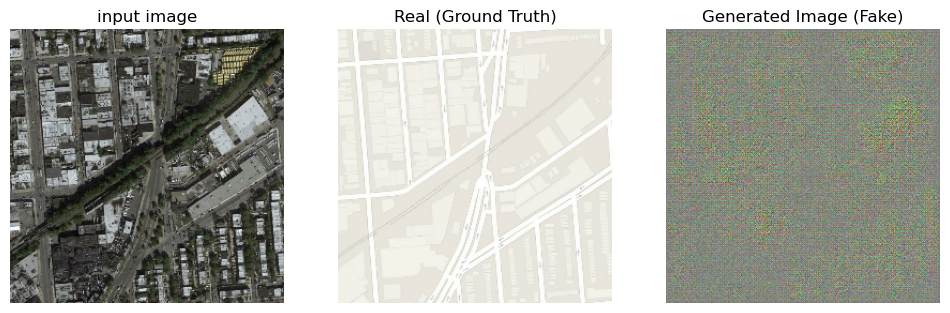

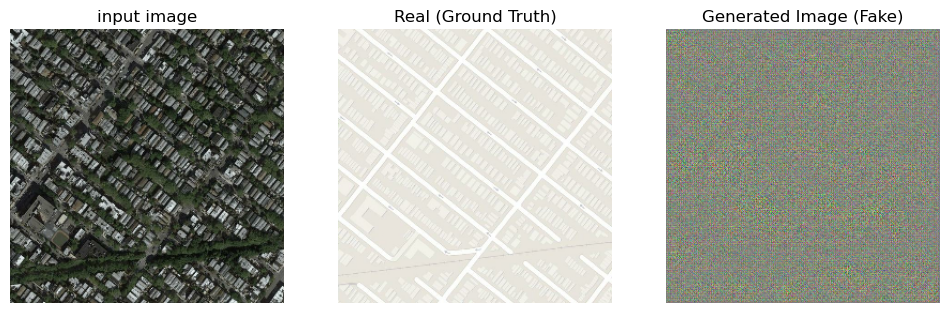

In [47]:
#test the function
for input_example, real_example in testing_dataset.take(2):
    generate_images(generator, input_example, real_example)

# Train the Model

In [48]:
path_log = 'pix2pix_map_logs/'
metrics = tf.summary.create_file_writer(path_log + 'fit/' + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))


In [49]:
@tf.function
def training_step(input_img, real, step):
    with tf.GradientTape() as g_tape, tf.GradientTape() as d_tape:
        g_output = generator(input_img, training= True)
        
        d_output_real = discriminator([input_img, real], training = True)
        d_output_generated = discriminator([input_img, g_output], training = True)
        
        g_total_loss, g_loss_gan, g_loss_l1 = generator_loss(d_output_generated, g_output, real)
        d_loss = discriminator_loss(d_output_real, d_output_generated)
    generator_gradients = g_tape.gradient(g_total_loss, generator.trainable_variables)
    discriminator_gradients = d_tape.gradient(d_loss, discriminator.trainable_variables)
    
    generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))
    
    with metrics.as_default():
        tf.summary.scalar('g_total_loss', g_total_loss, step = step//1000)
        tf.summary.scalar('g_loss_gan', g_loss_gan, step = step//1000)
        tf.summary.scalar('g_loss_l1', g_loss_l1, step = step//1000)
        tf.summary.scalar('d_loss', d_loss, step = step//1000)

In [50]:
def train(train_dataset, testing_dataset, steps):
    test_input, real_input = next(iter(testing_dataset.take(1)))
    start = time.time()
    
    for step, (input_img, real_img) in training_dataset.repeat().take(steps).enumerate():
        if step%1000 == 0:
            display.clear_output(wait = True)
            if step != 0:
                print(f'Time Taken to run 1000 steps: , {time.time() - start:.2f} seconds\n')
            strat = time.time()
            generate_images(generator, test_input, real_input, step)
            print(f'step: {step//1000}K')
        training_step(input_img, real_img, step)
        if (step+1)%10 == 0:
            print('.', end = '', flush = True)
        if (step + 1) % 5000 == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)
            generator.save_weights('model_weights_pix2pixgenerator_100k.weights.h5')

In [74]:
%load_ext tensorboard
%tensorboard --logdir {path_log}

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 32268), started 1 day, 1:45:57 ago. (Use '!kill 32268' to kill it.)

Time Taken to run 1000 steps: , 53569.69 seconds



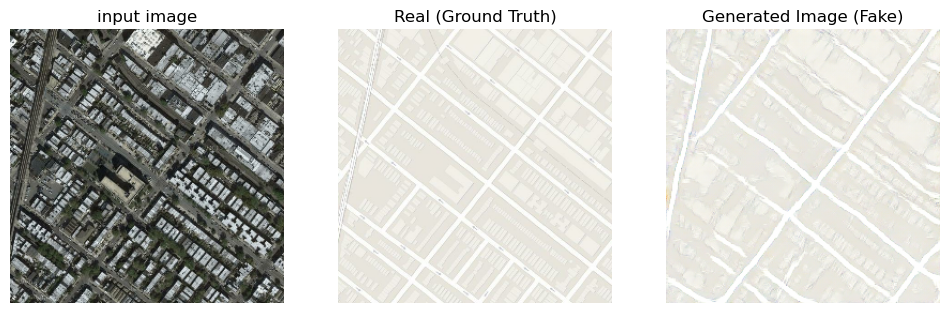

step: 119K
....................................................................................................

In [52]:
train(training_dataset, testing_dataset, steps = 120000)

In [54]:
tf.train.latest_checkpoint(checkpoint_dir)

'./pix2pix_map_train_checkpoints\\ckpt-24'

In [56]:
model2 = Generator()
model2.load_weights('model_weights_pix2pixgenerator_100k.weights.h5')

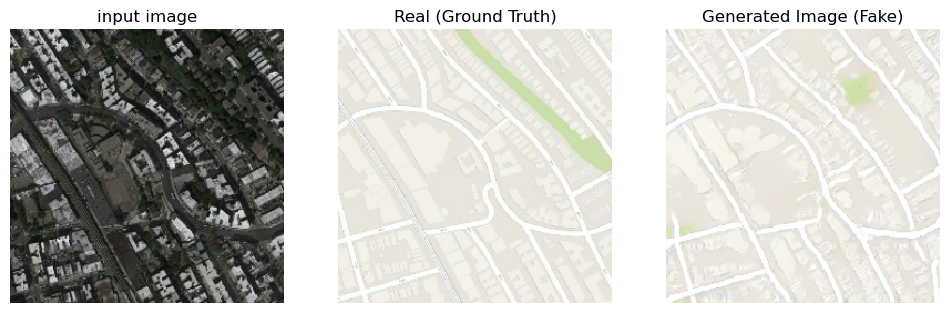

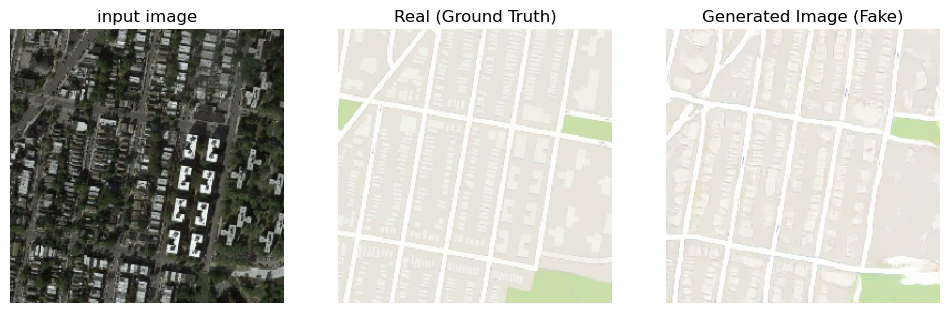

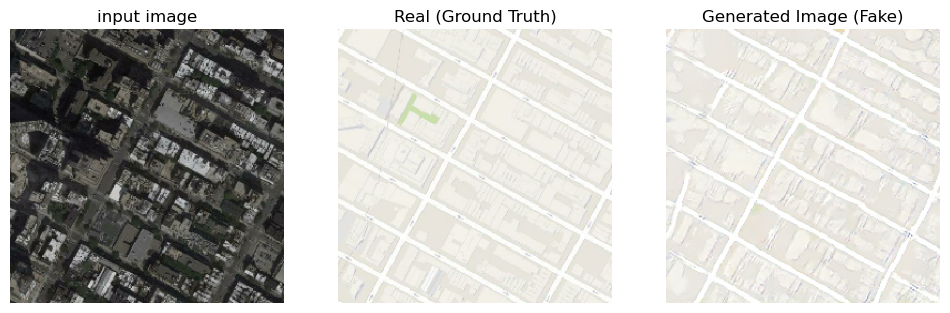

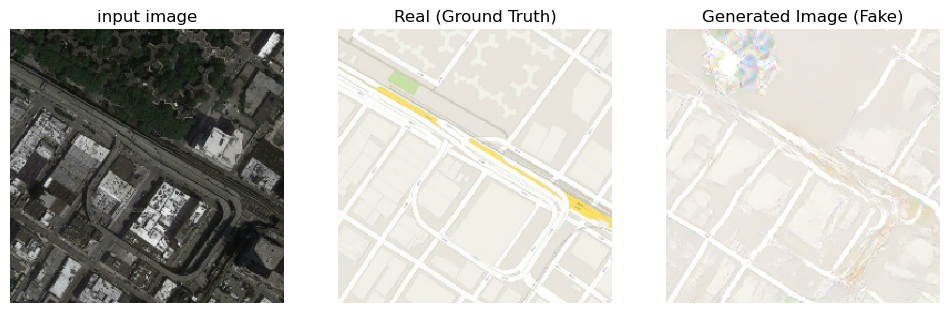

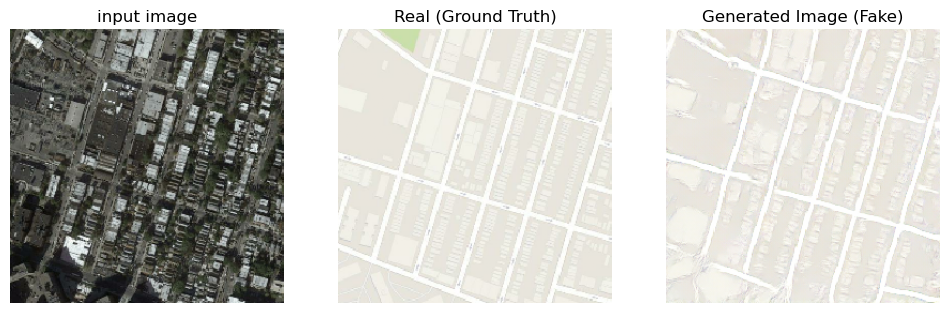

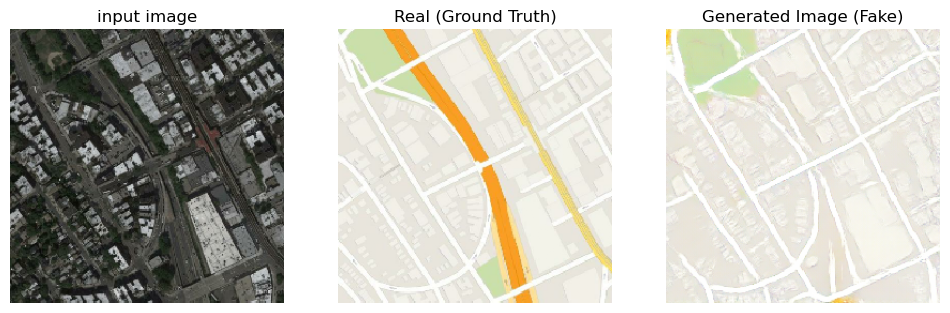

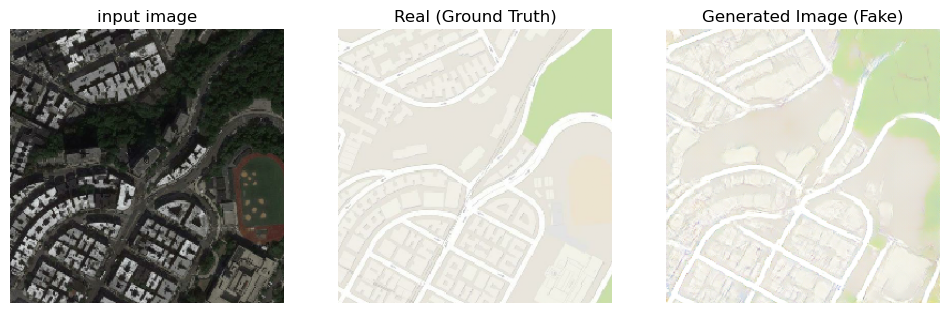

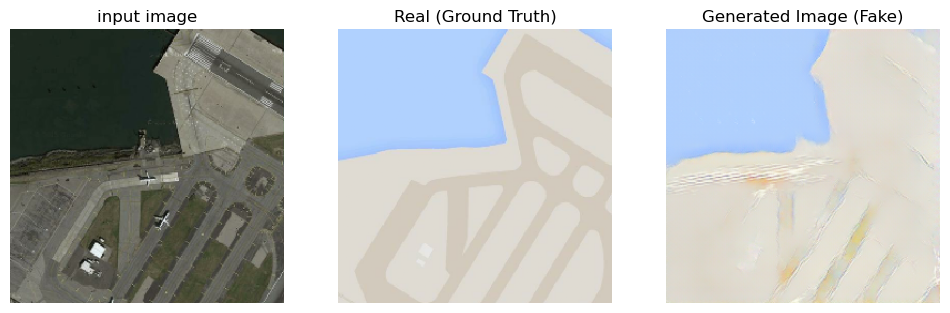

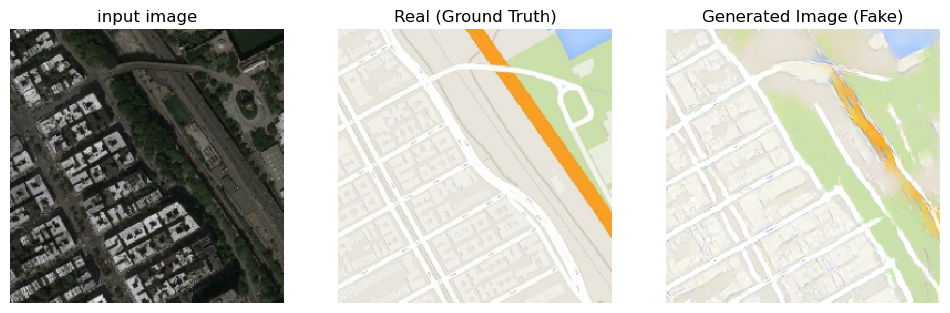

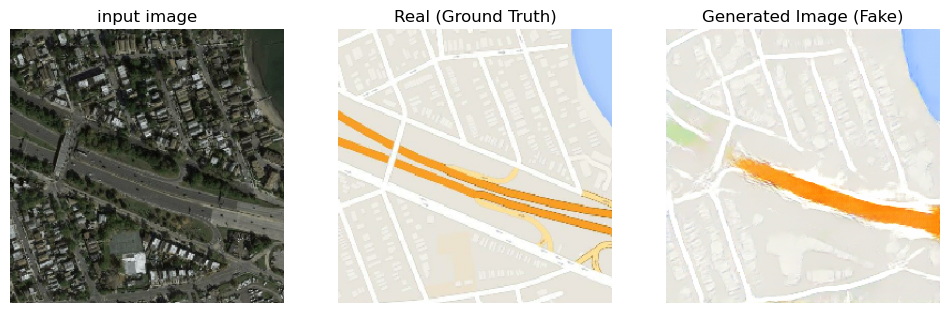

In [70]:
for s,m in training_dataset.take(10):
    generate_images(model2, s, m)

# Try New Image

In [66]:
generator.save('generator_model_mapdata_pix2pix_120k.keras')       
discriminator.save('discriminator_model_mapdata_pix2pix_120k.keras')  

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 257ms/step


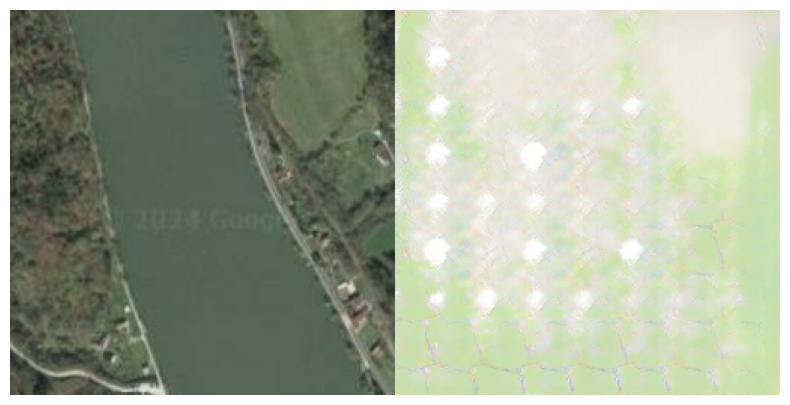

In [68]:
from tensorflow.keras.models import load_model
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Define functions for preprocessing, postprocessing, and displaying the images

# Preprocess input image (resize and normalize)
def preprocess_image(image_path):
    # Load the image
    image = Image.open(image_path)
    # Resize to 256x256 (or the size your model requires)
    image = image.resize((256, 256))
    # Convert the image to a numpy array
    image_array = np.array(image)
    # Normalize pixel values (Assuming GAN was trained with values in range [-1, 1])
    image_array = (image_array / 127.5) - 1.0
    # Add batch dimension for the GAN (assuming you're using a batch size of 1)
    image_array = np.expand_dims(image_array, axis=0)
    return image_array

# Post-process the generated image to convert it back to displayable format
def postprocess_image(fake_image):
    # Remove batch dimension
    fake_image = np.squeeze(fake_image, axis=0)
    # Rescale from [-1, 1] to [0, 255]
    fake_image = ((fake_image + 1.0) * 127.5).astype(np.uint8)
    # Convert numpy array back to an image
    return Image.fromarray(fake_image)

# Display input and generated images side by side
def display_images_side_by_side(input_img, generated_img):
    # Convert both images to numpy arrays
    input_img_array = np.array(input_img)
    generated_img_array = np.array(generated_img)
    
    # Concatenate images horizontally (axis=1)
    concatenated_image = np.concatenate((input_img_array, generated_img_array), axis=1)
    
    # Display the concatenated image
    plt.figure(figsize=(10, 5))  # Set figure size
    plt.imshow(concatenated_image)
    plt.axis('off')  # Hide axes
    plt.show()

# Step 2: Load the generator and discriminator models
generator = load_model('generator_model_mapdata_pix2pix_120k.keras')
discriminator = load_model('discriminator_model_mapdata_pix2pix_120k.keras')

# Step 3: Use an input image for testing
input_image_path = r"E:\Udemy\GAN_projects\Pix2pixgan\Map_dataset\Testing_images\t2.png" # Replace with the path to your input image
preprocessed_image = preprocess_image(input_image_path)

# Generate a fake map using the generator
fake_map = generator.predict(preprocessed_image)

# Step 4: Post-process the generated image
generated_image = postprocess_image(fake_map)

# Load the input image again for display (without preprocessing, just resizing for visualization)
input_image = Image.open(input_image_path).resize((256, 256))

# Step 5: Display input and generated images side by side
display_images_side_by_side(input_image, generated_image)


In [71]:
model4 = Generator()
model4.load_weights('model_weights_pix2pixgenerator_100k.weights.h5')

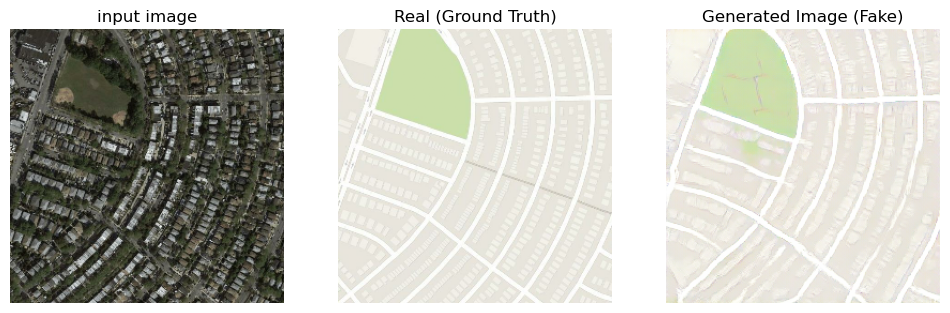

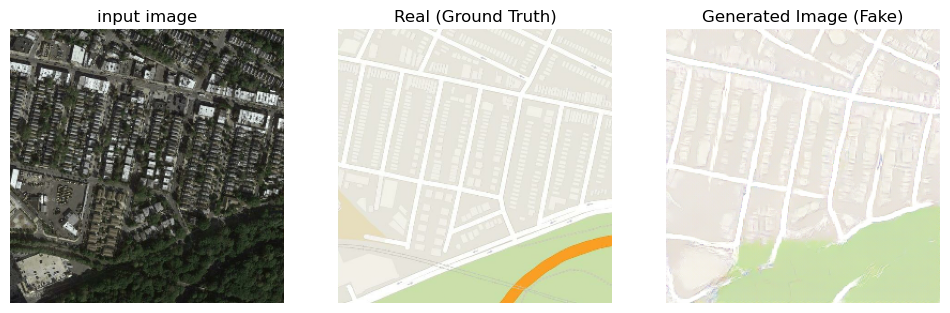

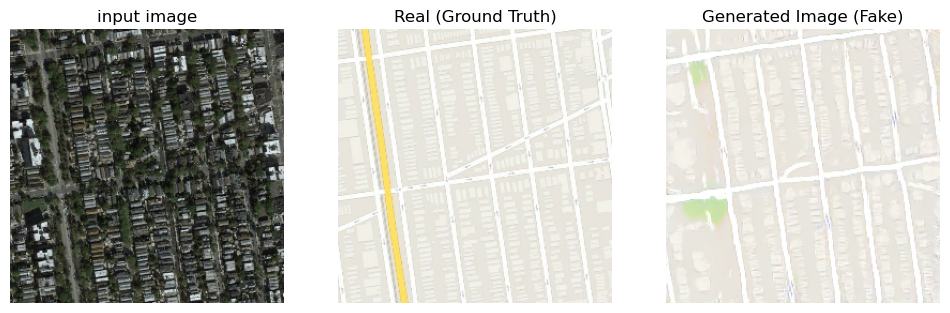

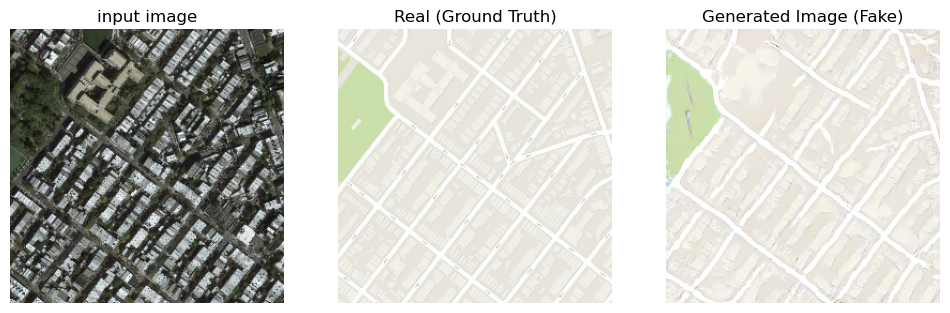

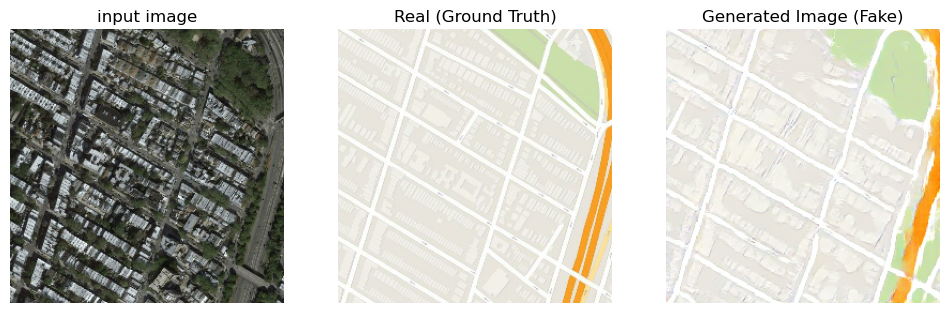

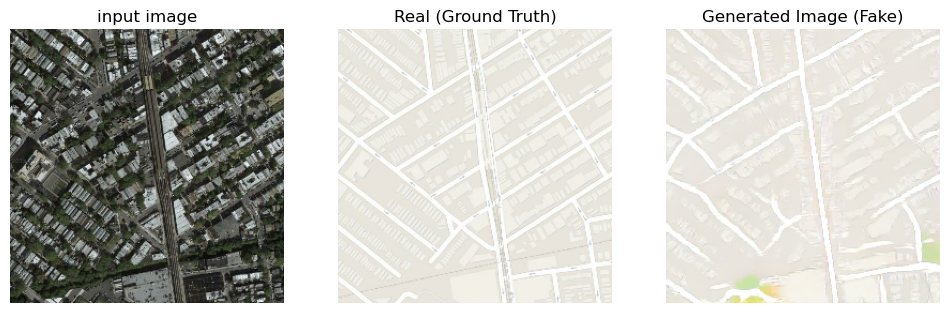

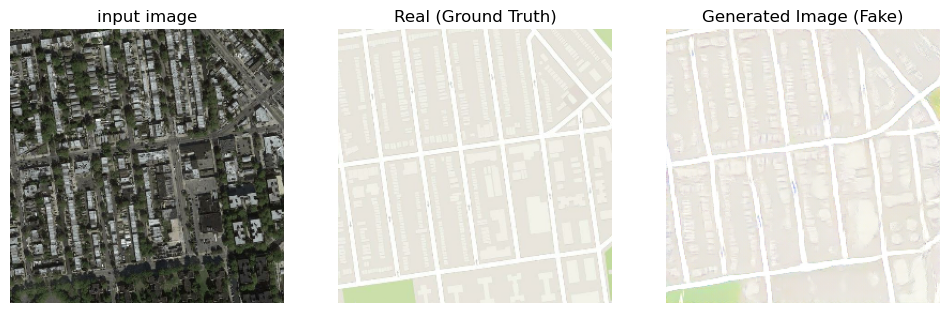

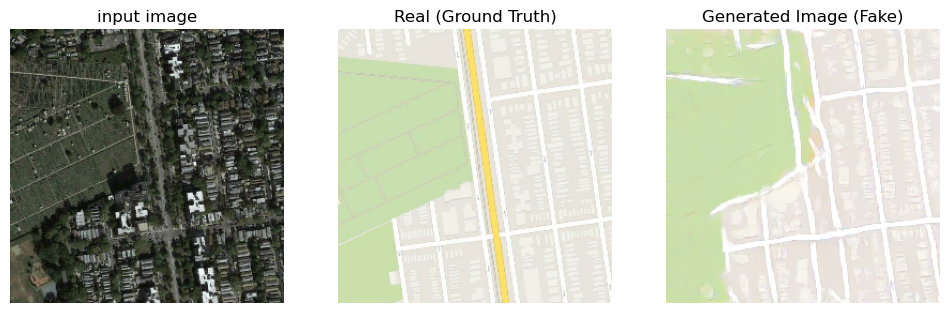

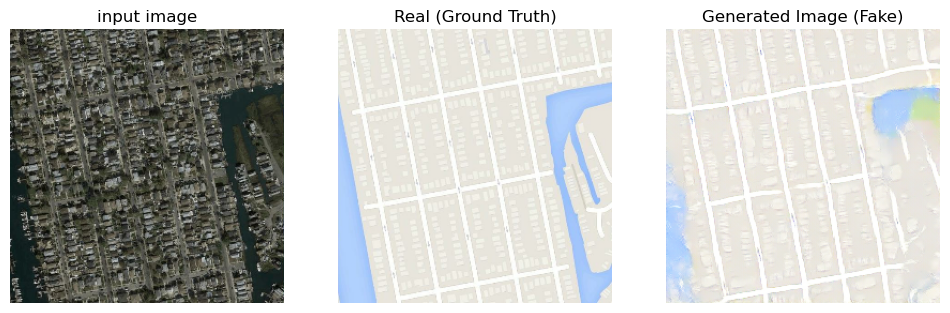

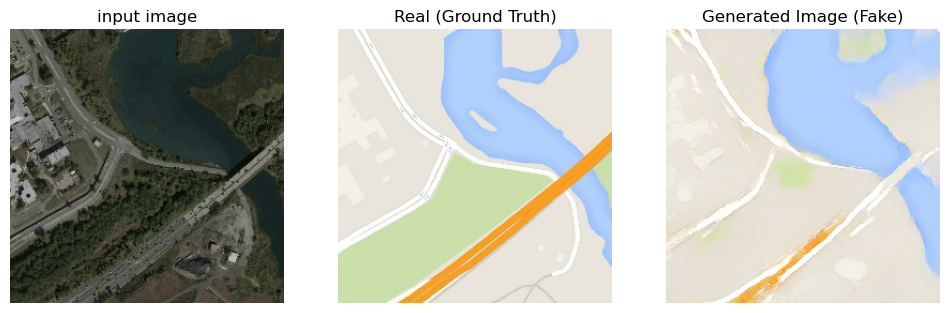

In [86]:
for s,m in testing_dataset.take(10):
    generate_images(model4, s, m)

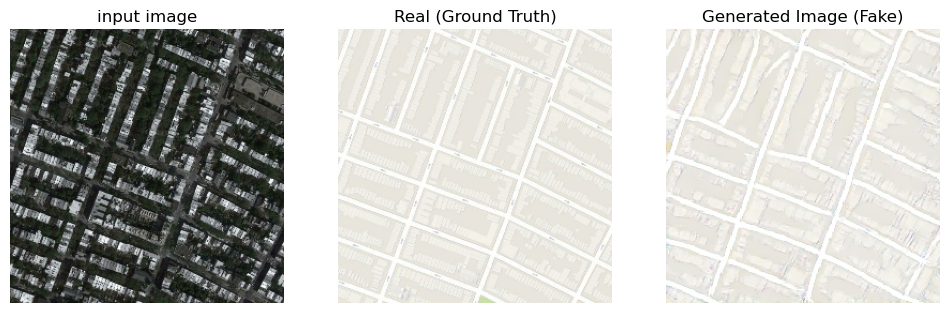

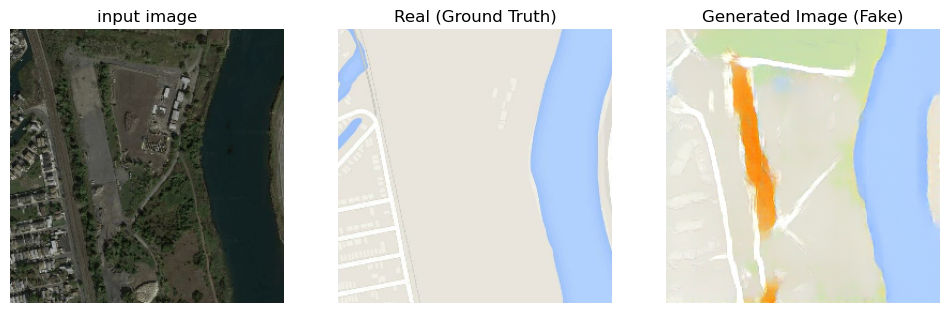

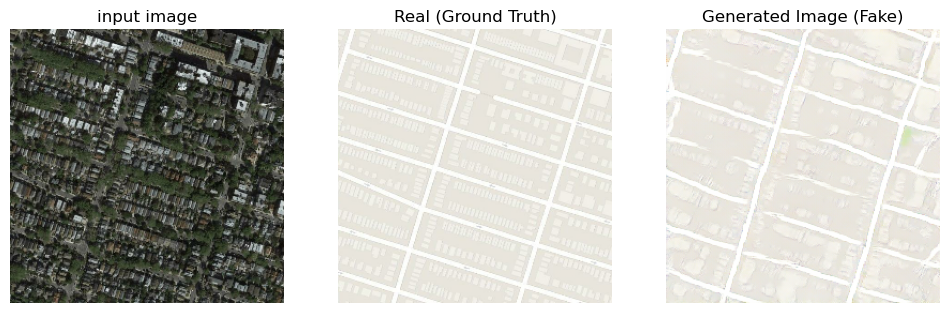

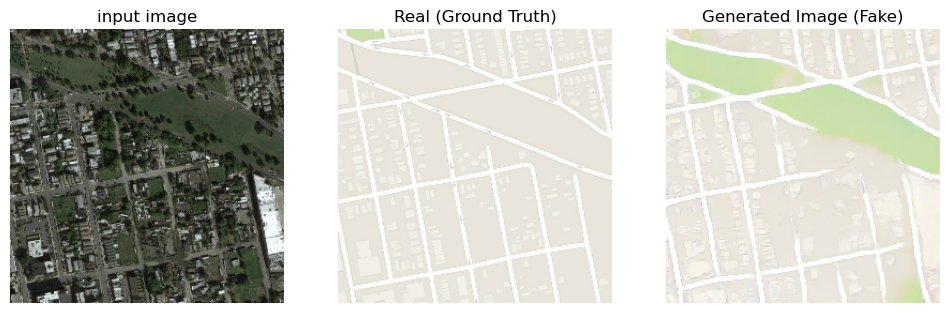

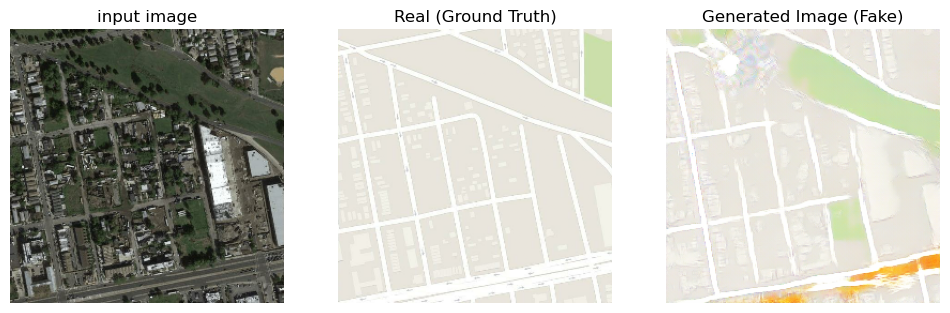

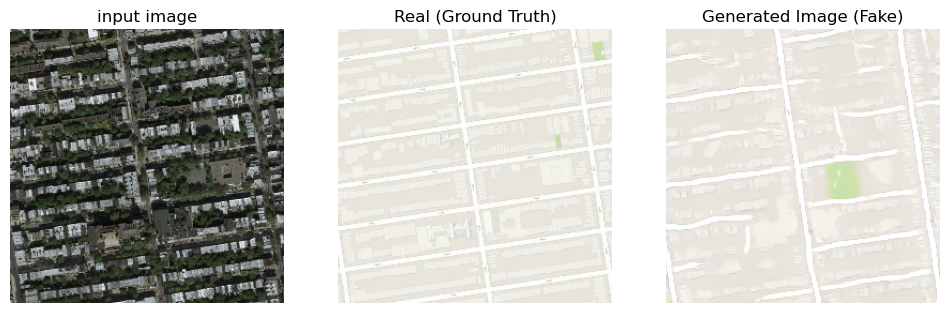

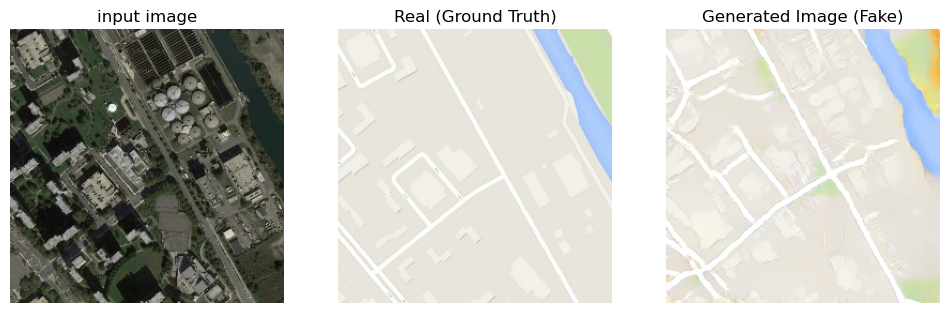

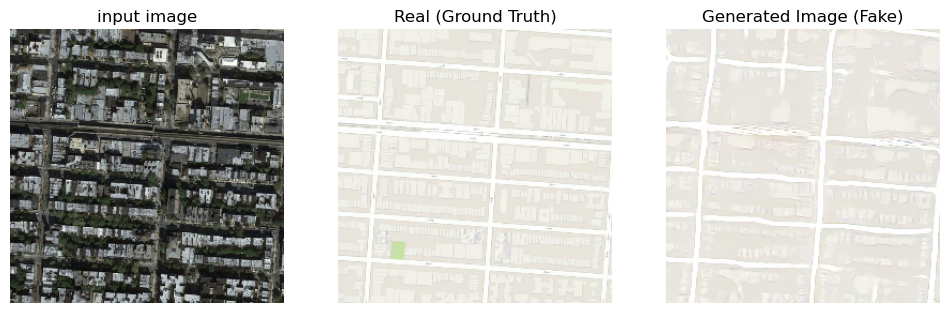

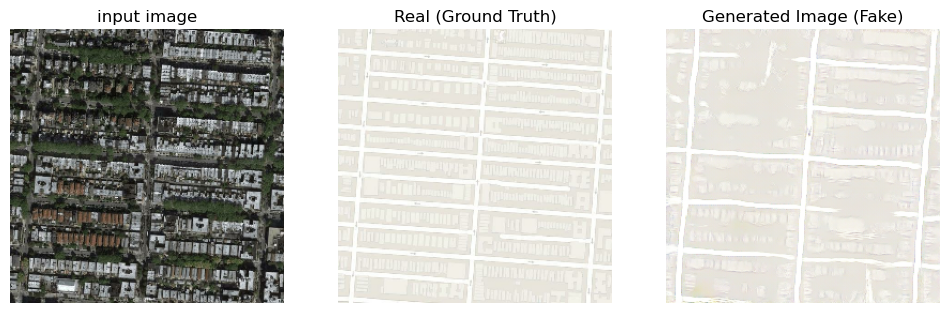

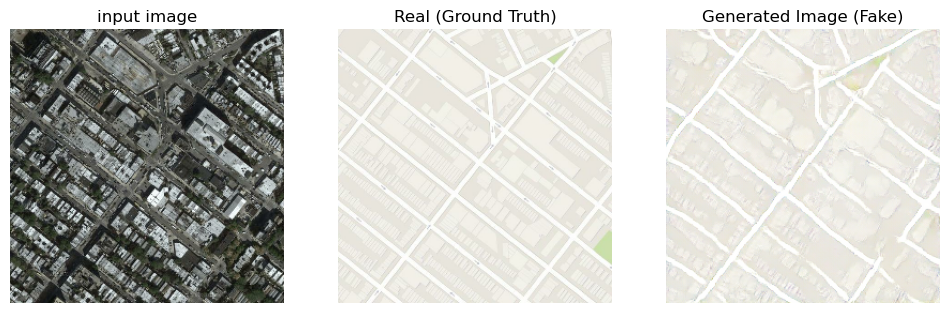

In [84]:
# Load the trained generator and discriminator models
generator = load_model('generator_model_mapdata_pix2pix_120k.keras')
discriminator = load_model('discriminator_model_mapdata_pix2pix_120k.keras')
for s,m in testing_dataset.take(10):
    generate_images(generator, s, m)